### 1. Se pide:

A partir del archivo "USA_Housing.csv", realizar la regresión no lineal entre cada columna numérica con la columna 'price' utilizando:

- Regresión polinómica no lineal con grados del 2 al 10. ¿El score se estanca a partir de cierto grado?
- SVR

In [2]:
import pandas as pd

df = pd.read_csv("../data/USA_Housing.csv")
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\r\nLaurabury, NE 37..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\r\nLake Kathleen, ..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\r\nDanieltown, WI 064..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\r\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\r\nFPO AE 09386
...,...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06,USNS Williams\r\nFPO AP 30153-7653
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06,"PSC 9258, Box 8489\r\nAPO AA 42991-3352"
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06,"4215 Tracy Garden Suite 076\r\nJoshualand, VA ..."
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06,USS Wallace\r\nFPO AE 73316


### 2. Se pide:

En el anterior dataset, la columna "Avg. Area Number of Bedrooms" está en un rango numérico limitado:

1. Cambia todos los datos para que sean enteros redondeando hacia el entero más cercano. Si es .5 exacto, se redondea hacia abajo.

2. Cuando lo hayas hecho, tendras una columna con números enteros en un rango limitado. Ahora trata a esa columna como una serie de valores discretos (classes, labels). 

3. Usando las demás columnas numéricas y una a una, utiliza SVM para clasificar esa columna modificada.

4. Usando todas las demás columnas a la vez, utiliza SVM para clasificar esa columna modificada. Es decir, "Avg. Area Income" con nuestro target, después "Avg. Area House Age", ... ¿hace aumentar el score? ¿por qué? 

5. ¿Qué columna tiene mejor correlación con "Avg. Area Number of Bedrooms" una vez modificada? ¿qué columna da mejor score para nuestro target? 

In [3]:

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score, mean_absolute_error
import numpy as np

In [4]:
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\r\nLaurabury, NE 37..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\r\nLake Kathleen, ..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\r\nDanieltown, WI 064..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\r\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\r\nFPO AE 09386
...,...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06,USNS Williams\r\nFPO AP 30153-7653
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06,"PSC 9258, Box 8489\r\nAPO AA 42991-3352"
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06,"4215 Tracy Garden Suite 076\r\nJoshualand, VA ..."
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06,USS Wallace\r\nFPO AE 73316


In [5]:
df.columns


Index(['Avg. Area Income', 'Avg. Area House Age', 'Avg. Area Number of Rooms',
       'Avg. Area Number of Bedrooms', 'Area Population', 'Price', 'Address'],
      dtype='object')

In [6]:
df=df.iloc[:,0:6]
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05
...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06


In [7]:
y=df.iloc[:,-1]
y

0       1.059034e+06
1       1.505891e+06
2       1.058988e+06
3       1.260617e+06
4       6.309435e+05
            ...     
4995    1.060194e+06
4996    1.482618e+06
4997    1.030730e+06
4998    1.198657e+06
4999    1.298950e+06
Name: Price, Length: 5000, dtype: float64

In [8]:
y=np.array(y)
y.shape


(5000,)

In [9]:
X_1=df.iloc[:,0]
X_1

0       79545.458574
1       79248.642455
2       61287.067179
3       63345.240046
4       59982.197226
            ...     
4995    60567.944140
4996    78491.275435
4997    63390.686886
4998    68001.331235
4999    65510.581804
Name: Avg. Area Income, Length: 5000, dtype: float64

In [10]:
X_1=np.array(X_1)

In [11]:
X_train, X_test, y_train, y_test = train_test_split(X_1, y,test_size=0.2)

################
[[1.00000000e+00 6.84230232e+04 4.68171010e+09]
 [1.00000000e+00 6.96477086e+04 4.85080332e+09]
 [1.00000000e+00 7.10821128e+04 5.05266676e+09]
 ...
 [1.00000000e+00 7.63575308e+04 5.83047250e+09]
 [1.00000000e+00 6.75478711e+04 4.56271489e+09]
 [1.00000000e+00 7.00218814e+04 4.90306388e+09]]
(4000, 3)
y_pred (4000,)
Score: 0.407227546688016


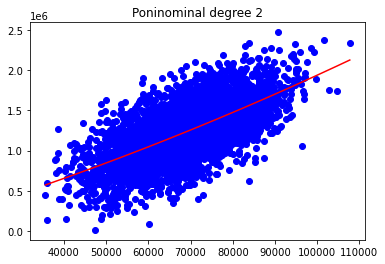

################
[[1.00000000e+00 6.84230232e+04 4.68171010e+09 3.20336759e+14]
 [1.00000000e+00 6.96477086e+04 4.85080332e+09 3.37847336e+14]
 [1.00000000e+00 7.10821128e+04 5.05266676e+09 3.59154228e+14]
 ...
 [1.00000000e+00 7.63575308e+04 5.83047250e+09 4.45200483e+14]
 [1.00000000e+00 6.75478711e+04 4.56271489e+09 3.08201677e+14]
 [1.00000000e+00 7.00218814e+04 4.90306388e+09 3.43321758e+14]]
(4000, 4)
y_pred (4000,)
Score: 0.4072277040742406


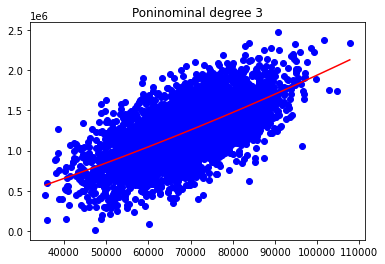

################
[[1.00000000e+00 6.84230232e+04 4.68171010e+09 3.20336759e+14
  2.19184095e+19]
 [1.00000000e+00 6.96477086e+04 4.85080332e+09 3.37847336e+14
  2.35302928e+19]
 [1.00000000e+00 7.10821128e+04 5.05266676e+09 3.59154228e+14
  2.55294414e+19]
 ...
 [1.00000000e+00 7.63575308e+04 5.83047250e+09 4.45200483e+14
  3.39944096e+19]
 [1.00000000e+00 6.75478711e+04 4.56271489e+09 3.08201677e+14
  2.08183671e+19]
 [1.00000000e+00 7.00218814e+04 4.90306388e+09 3.43321758e+14
  2.40400354e+19]]
(4000, 5)
y_pred (4000,)
Score: 0.40726994980295195


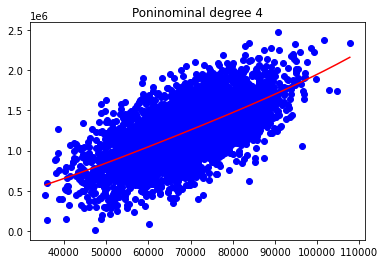

################
[[1.00000000e+00 6.84230232e+04 4.68171010e+09 3.20336759e+14
  2.19184095e+19 1.49972384e+24]
 [1.00000000e+00 6.96477086e+04 4.85080332e+09 3.37847336e+14
  2.35302928e+19 1.63883098e+24]
 [1.00000000e+00 7.10821128e+04 5.05266676e+09 3.59154228e+14
  2.55294414e+19 1.81468663e+24]
 ...
 [1.00000000e+00 7.63575308e+04 5.83047250e+09 4.45200483e+14
  3.39944096e+19 2.59572918e+24]
 [1.00000000e+00 6.75478711e+04 4.56271489e+09 3.08201677e+14
  2.08183671e+19 1.40623638e+24]
 [1.00000000e+00 7.00218814e+04 4.90306388e+09 3.43321758e+14
  2.40400354e+19 1.68332851e+24]]
(4000, 6)
y_pred (4000,)
Score: 0.4073540858838598


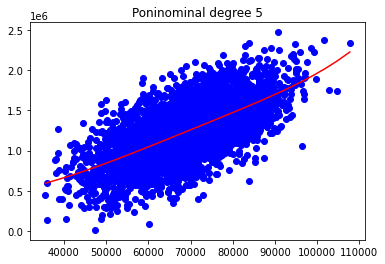

################
[[1.00000000e+00 6.84230232e+04 4.68171010e+09 ... 2.19184095e+19
  1.49972384e+24 1.02615639e+29]
 [1.00000000e+00 6.96477086e+04 4.85080332e+09 ... 2.35302928e+19
  1.63883098e+24 1.14140823e+29]
 [1.00000000e+00 7.10821128e+04 5.05266676e+09 ... 2.55294414e+19
  1.81468663e+24 1.28991760e+29]
 ...
 [1.00000000e+00 7.63575308e+04 5.83047250e+09 ... 3.39944096e+19
  2.59572918e+24 1.98203471e+29]
 [1.00000000e+00 6.75478711e+04 4.56271489e+09 ... 2.08183671e+19
  1.40623638e+24 9.49882736e+28]
 [1.00000000e+00 7.00218814e+04 4.90306388e+09 ... 2.40400354e+19
  1.68332851e+24 1.17869829e+29]]
(4000, 7)
y_pred (4000,)
Score: 0.40731469860453706


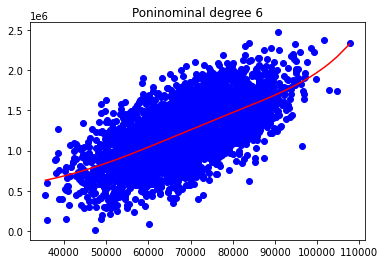

################
[[1.00000000e+00 6.84230232e+04 4.68171010e+09 ... 1.49972384e+24
  1.02615639e+29 7.02127225e+33]
 [1.00000000e+00 6.96477086e+04 4.85080332e+09 ... 1.63883098e+24
  1.14140823e+29 7.94964676e+33]
 [1.00000000e+00 7.10821128e+04 5.05266676e+09 ... 1.81468663e+24
  1.28991760e+29 9.16900681e+33]
 ...
 [1.00000000e+00 7.63575308e+04 5.83047250e+09 ... 2.59572918e+24
  1.98203471e+29 1.51343276e+34]
 [1.00000000e+00 6.75478711e+04 4.56271489e+09 ... 1.40623638e+24
  9.49882736e+28 6.41625566e+33]
 [1.00000000e+00 7.00218814e+04 4.90306388e+09 ... 1.68332851e+24
  1.17869829e+29 8.25346721e+33]]
(4000, 8)
y_pred (4000,)
Score: 0.4067981966012575


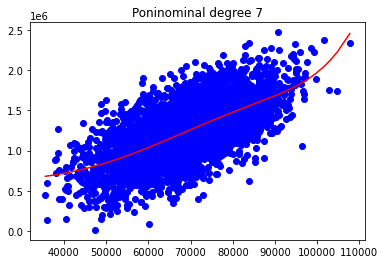

################
[[1.00000000e+00 6.84230232e+04 4.68171010e+09 ... 1.02615639e+29
  7.02127225e+33 4.80416674e+38]
 [1.00000000e+00 6.96477086e+04 4.85080332e+09 ... 1.14140823e+29
  7.94964676e+33 5.53674682e+38]
 [1.00000000e+00 7.10821128e+04 5.05266676e+09 ... 1.28991760e+29
  9.16900681e+33 6.51752376e+38]
 ...
 [1.00000000e+00 7.63575308e+04 5.83047250e+09 ... 1.98203471e+29
  1.51343276e+34 1.15561988e+39]
 [1.00000000e+00 6.75478711e+04 4.56271489e+09 ... 9.49882736e+28
  6.41625566e+33 4.33404410e+38]
 [1.00000000e+00 7.00218814e+04 4.90306388e+09 ... 1.17869829e+29
  8.25346721e+33 5.77923302e+38]]
(4000, 9)
y_pred (4000,)
Score: 0.4053481559848263


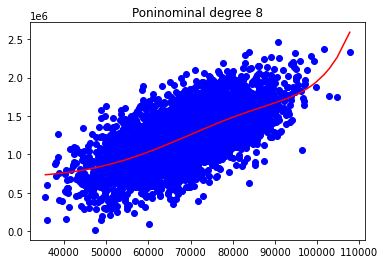

################
[[1.00000000e+00 6.84230232e+04 4.68171010e+09 ... 7.02127225e+33
  4.80416674e+38 3.28715612e+43]
 [1.00000000e+00 6.96477086e+04 4.85080332e+09 ... 7.94964676e+33
  5.53674682e+38 3.85621729e+43]
 [1.00000000e+00 7.10821128e+04 5.05266676e+09 ... 9.16900681e+33
  6.51752376e+38 4.63279359e+43]
 ...
 [1.00000000e+00 7.63575308e+04 5.83047250e+09 ... 1.51343276e+34
  1.15561988e+39 8.82402809e+43]
 [1.00000000e+00 6.75478711e+04 4.56271489e+09 ... 6.41625566e+33
  4.33404410e+38 2.92755452e+43]
 [1.00000000e+00 7.00218814e+04 4.90306388e+09 ... 8.25346721e+33
  5.77923302e+38 4.04672769e+43]]
(4000, 10)
y_pred (4000,)
Score: 0.40253084275377815


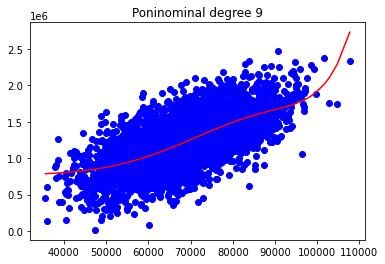

################
[[1.00000000e+00 6.84230232e+04 4.68171010e+09 ... 4.80416674e+38
  3.28715612e+43 2.24917160e+48]
 [1.00000000e+00 6.96477086e+04 4.85080332e+09 ... 5.53674682e+38
  3.85621729e+43 2.68576698e+48]
 [1.00000000e+00 7.10821128e+04 5.05266676e+09 ... 6.51752376e+38
  4.63279359e+43 3.29308756e+48]
 ...
 [1.00000000e+00 7.63575308e+04 5.83047250e+09 ... 1.15561988e+39
  8.82402809e+43 6.73780996e+48]
 [1.00000000e+00 6.75478711e+04 4.56271489e+09 ... 4.33404410e+38
  2.92755452e+43 1.97750075e+48]
 [1.00000000e+00 7.00218814e+04 4.90306388e+09 ... 5.77923302e+38
  4.04672769e+43 2.83359487e+48]]
(4000, 11)
y_pred (4000,)
Score: 0.39802486853180574


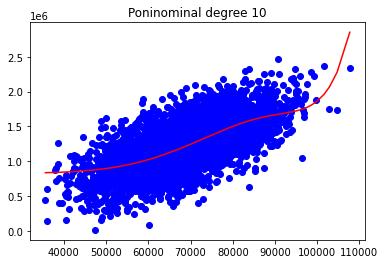

In [12]:
# GRADOS MINIMO Y MAXIMO 
degree_min = 2
degree_max = 10
#ACIERTOS
scores = []
for degree in range(degree_min,degree_max+1):
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    #ENTRENAMOS CON EL CONJUNTO DE ENTRENAMIEMTO
    X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1),y_train)

    #######
    print(X_poly)
    print(X_poly.shape)

    lin_reg_model = LinearRegression() 
    lin_reg_model.fit(X_poly, y_train)#LA REGRESION VA A APRENDER X_POLY PARA ENTRENAR
    y_pred = lin_reg_model.predict(X_poly) #PREDICE LAS Y CON LOS DATOS DE X_POLY

    print("y_pred", y_pred.shape)
    print("Score:", r2_score(y_train, y_pred))

    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
    plt.plot(X_train_to_show, y_pred, color='red')
    plt.title("Poninominal degree " + str(degree))
    plt.show()
   

In [13]:
X=df.iloc[:,1]
X

0       5.682861
1       6.002900
2       5.865890
3       7.188236
4       5.040555
          ...   
4995    7.830362
4996    6.999135
4997    7.250591
4998    5.534388
4999    5.992305
Name: Avg. Area House Age, Length: 5000, dtype: float64

In [14]:
X=np.array(X)

In [15]:
X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=0.2)

################
[[ 1.          5.4634655  29.84945523]
 [ 1.          7.7045052  59.35940038]
 [ 1.          5.25710092 27.63711011]
 ...
 [ 1.          5.69179836 32.39656855]
 [ 1.          7.03076057 49.43159425]
 [ 1.          3.98995051 15.91970503]]
(4000, 3)
y_pred (4000,)
Score: 0.20125054702296152


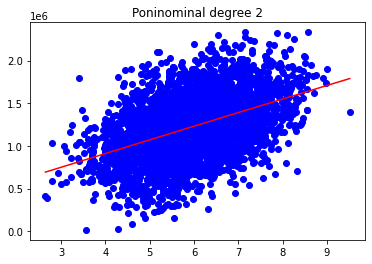

################
[[  1.           5.4634655   29.84945523 163.08146877]
 [  1.           7.7045052   59.35940038 457.33480896]
 [  1.           5.25710092  27.63711011 145.29107702]
 ...
 [  1.           5.69179836  32.39656855 184.39473566]
 [  1.           7.03076057  49.43159425 347.541704  ]
 [  1.           3.98995051  15.91970503  63.51883514]]
(4000, 4)
y_pred (4000,)
Score: 0.20141605686374842


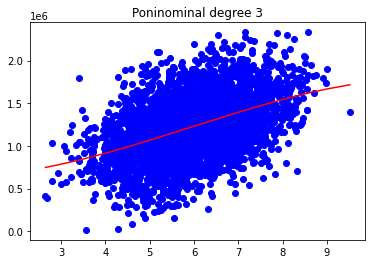

################
[[1.00000000e+00 5.46346550e+00 2.98494552e+01 1.63081469e+02
  8.90989978e+02]
 [1.00000000e+00 7.70450520e+00 5.93594004e+01 4.57334809e+02
  3.52353841e+03]
 [1.00000000e+00 5.25710092e+00 2.76371101e+01 1.45291077e+02
  7.63809855e+02]
 ...
 [1.00000000e+00 5.69179836e+00 3.23965685e+01 1.84394736e+02
  1.04953765e+03]
 [1.00000000e+00 7.03076057e+00 4.94315943e+01 3.47541704e+02
  2.44348251e+03]
 [1.00000000e+00 3.98995051e+00 1.59197050e+01 6.35188351e+01
  2.53437008e+02]]
(4000, 5)
y_pred (4000,)
Score: 0.2014516993456813


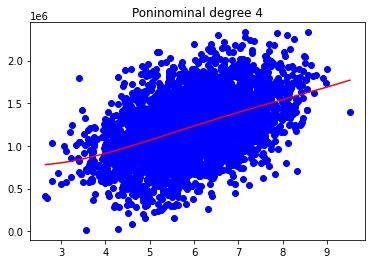

################
[[1.00000000e+00 5.46346550e+00 2.98494552e+01 1.63081469e+02
  8.90989978e+02 4.86789300e+03]
 [1.00000000e+00 7.70450520e+00 5.93594004e+01 4.57334809e+02
  3.52353841e+03 2.71471200e+04]
 [1.00000000e+00 5.25710092e+00 2.76371101e+01 1.45291077e+02
  7.63809855e+02 4.01542549e+03]
 ...
 [1.00000000e+00 5.69179836e+00 3.23965685e+01 1.84394736e+02
  1.04953765e+03 5.97375669e+03]
 [1.00000000e+00 7.03076057e+00 4.94315943e+01 3.47541704e+02
  2.44348251e+03 1.71795405e+04]
 [1.00000000e+00 3.98995051e+00 1.59197050e+01 6.35188351e+01
  2.53437008e+02 1.01120112e+03]]
(4000, 6)
y_pred (4000,)
Score: 0.20188171985789838


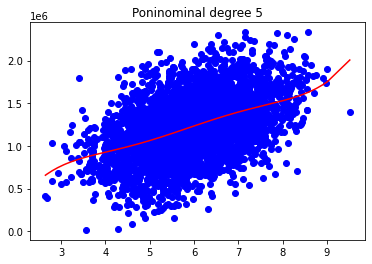

################
[[1.00000000e+00 5.46346550e+00 2.98494552e+01 ... 8.90989978e+02
  4.86789300e+03 2.65955655e+04]
 [1.00000000e+00 7.70450520e+00 5.93594004e+01 ... 3.52353841e+03
  2.71471200e+04 2.09155127e+05]
 [1.00000000e+00 5.25710092e+00 2.76371101e+01 ... 7.63809855e+02
  4.01542549e+03 2.11094971e+04]
 ...
 [1.00000000e+00 5.69179836e+00 3.23965685e+01 ... 1.04953765e+03
  5.97375669e+03 3.40014185e+04]
 [1.00000000e+00 7.03076057e+00 4.94315943e+01 ... 2.44348251e+03
  1.71795405e+04 1.20785236e+05]
 [1.00000000e+00 3.98995051e+00 1.59197050e+01 ... 2.53437008e+02
  1.01120112e+03 4.03464242e+03]]
(4000, 7)
y_pred (4000,)
Score: 0.20260888376914699


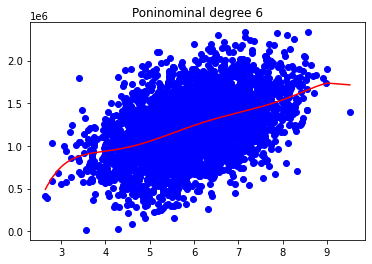

################
[[1.00000000e+00 5.46346550e+00 2.98494552e+01 ... 4.86789300e+03
  2.65955655e+04 1.45303954e+05]
 [1.00000000e+00 7.70450520e+00 5.93594004e+01 ... 2.71471200e+04
  2.09155127e+05 1.61143677e+06]
 [1.00000000e+00 5.25710092e+00 2.76371101e+01 ... 4.01542549e+03
  2.11094971e+04 1.10974756e+05]
 ...
 [1.00000000e+00 5.69179836e+00 3.23965685e+01 ... 5.97375669e+03
  3.40014185e+04 1.93529218e+05]
 [1.00000000e+00 7.03076057e+00 4.94315943e+01 ... 1.71795405e+04
  1.20785236e+05 8.49212075e+05]
 [1.00000000e+00 3.98995051e+00 1.59197050e+01 ... 1.01120112e+03
  4.03464242e+03 1.60980236e+04]]
(4000, 8)
y_pred (4000,)
Score: 0.20349404085442724


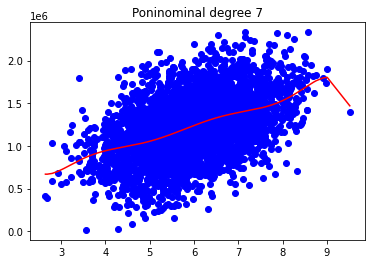

################
[[1.00000000e+00 5.46346550e+00 2.98494552e+01 ... 2.65955655e+04
  1.45303954e+05 7.93863140e+05]
 [1.00000000e+00 7.70450520e+00 5.93594004e+01 ... 2.09155127e+05
  1.61143677e+06 1.24153230e+07]
 [1.00000000e+00 5.25710092e+00 2.76371101e+01 ... 2.11094971e+04
  1.10974756e+05 5.83405495e+05]
 ...
 [1.00000000e+00 5.69179836e+00 3.23965685e+01 ... 3.40014185e+04
  1.93529218e+05 1.10152929e+06]
 [1.00000000e+00 7.03076057e+00 4.94315943e+01 ... 1.20785236e+05
  8.49212075e+05 5.97060678e+06]
 [1.00000000e+00 3.98995051e+00 1.59197050e+01 ... 4.03464242e+03
  1.60980236e+04 6.42303172e+04]]
(4000, 9)
y_pred (4000,)
Score: 0.2041915307321437


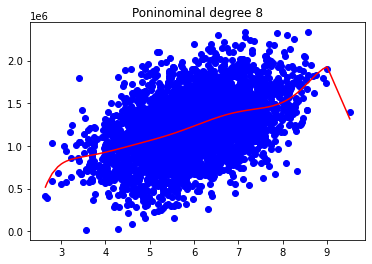

################
[[1.00000000e+00 5.46346550e+00 2.98494552e+01 ... 1.45303954e+05
  7.93863140e+05 4.33724388e+06]
 [1.00000000e+00 7.70450520e+00 5.93594004e+01 ... 1.61143677e+06
  1.24153230e+07 9.56539203e+07]
 [1.00000000e+00 5.25710092e+00 2.76371101e+01 ... 1.10974756e+05
  5.83405495e+05 3.06702156e+06]
 ...
 [1.00000000e+00 5.69179836e+00 3.23965685e+01 ... 1.93529218e+05
  1.10152929e+06 6.26968258e+06]
 [1.00000000e+00 7.03076057e+00 4.94315943e+01 ... 8.49212075e+05
  5.97060678e+06 4.19779067e+07]
 [1.00000000e+00 3.98995051e+00 1.59197050e+01 ... 1.60980236e+04
  6.42303172e+04 2.56275787e+05]]
(4000, 10)
y_pred (4000,)
Score: 0.2051146442211046


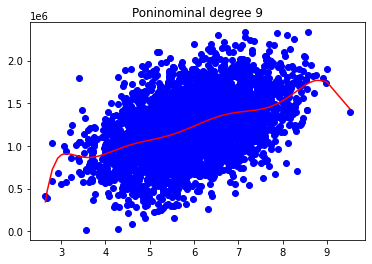

################
[[1.00000000e+00 5.46346550e+00 2.98494552e+01 ... 7.93863140e+05
  4.33724388e+06 2.36963823e+07]
 [1.00000000e+00 7.70450520e+00 5.93594004e+01 ... 1.24153230e+07
  9.56539203e+07 7.36966126e+08]
 [1.00000000e+00 5.25710092e+00 2.76371101e+01 ... 5.83405495e+05
  3.06702156e+06 1.61236419e+07]
 ...
 [1.00000000e+00 5.69179836e+00 3.23965685e+01 ... 1.10152929e+06
  6.26968258e+06 3.56857690e+07]
 [1.00000000e+00 7.03076057e+00 4.94315943e+01 ... 5.97060678e+06
  4.19779067e+07 2.95136612e+08]
 [1.00000000e+00 3.98995051e+00 1.59197050e+01 ... 6.42303172e+04
  2.56275787e+05 1.02252770e+06]]
(4000, 11)
y_pred (4000,)
Score: 0.20517768989253737


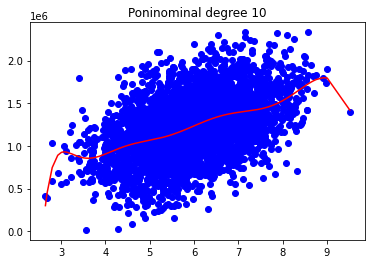

In [16]:
# GRADOS MINIMO Y MAXIMO 
degree_min = 2
degree_max = 10
#ACIERTOS
scores = []
for degree in range(degree_min,degree_max+1):
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    #ENTRENAMOS CON EL CONJUNTO DE ENTRENAMIEMTO
    X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1),y_train)

    #######
    print(X_poly)
    print(X_poly.shape)

    lin_reg_model = LinearRegression() 
    lin_reg_model.fit(X_poly, y_train)#LA REGRESION VA A APRENDER X_POLY PARA ENTRENAR
    y_pred = lin_reg_model.predict(X_poly) #PREDICE LAS Y CON LOS DATOS DE X_POLY

    print("y_pred", y_pred.shape)
    print("Score:", r2_score(y_train, y_pred))

    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
    plt.plot(X_train_to_show, y_pred, color='red')
    plt.title("Poninominal degree " + str(degree))
    plt.show()

In [17]:
X_2=df.iloc[:,2]
X_2

0       7.009188
1       6.730821
2       8.512727
3       5.586729
4       7.839388
          ...   
4995    6.137356
4996    6.576763
4997    4.805081
4998    7.130144
4999    6.792336
Name: Avg. Area Number of Rooms, Length: 5000, dtype: float64

In [18]:
X_2=np.array(X_2)

In [19]:
X_train, X_test, y_train, y_test = train_test_split(X_2, y,test_size=0.2)

################
[[ 1.          6.77106398 45.84730747]
 [ 1.          5.47525265 29.97839162]
 [ 1.          5.45592987 29.76717075]
 ...
 [ 1.          5.72736776 32.80274141]
 [ 1.          4.70501539 22.1371698 ]
 [ 1.          7.7905175  60.69216296]]
(4000, 3)
y_pred (4000,)
Score: 0.11377222738802273


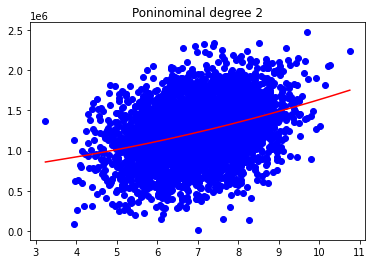

################
[[  1.           6.77106398  45.84730747 310.43505239]
 [  1.           5.47525265  29.97839162 164.13926826]
 [  1.           5.45592987  29.76717075 162.40759606]
 ...
 [  1.           5.72736776  32.80274141 187.87336348]
 [  1.           4.70501539  22.1371698  104.15572453]
 [  1.           7.7905175   60.69216296 472.82335784]]
(4000, 4)
y_pred (4000,)
Score: 0.11418701578090151


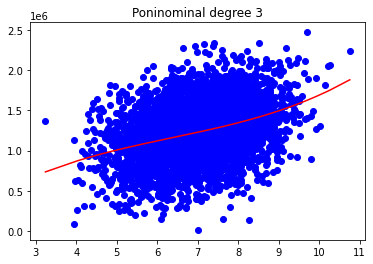

################
[[1.00000000e+00 6.77106398e+00 4.58473075e+01 3.10435052e+02
  2.10197560e+03]
 [1.00000000e+00 5.47525265e+00 2.99783916e+01 1.64139268e+02
  8.98703964e+02]
 [1.00000000e+00 5.45592987e+00 2.97671708e+01 1.62407596e+02
  8.86084455e+02]
 ...
 [1.00000000e+00 5.72736776e+00 3.28027414e+01 1.87873363e+02
  1.07601984e+03]
 [1.00000000e+00 4.70501539e+00 2.21371698e+01 1.04155725e+02
  4.90054287e+02]
 [1.00000000e+00 7.79051750e+00 6.06921630e+01 4.72823358e+02
  3.68353865e+03]]
(4000, 5)
y_pred (4000,)
Score: 0.1149565080164634


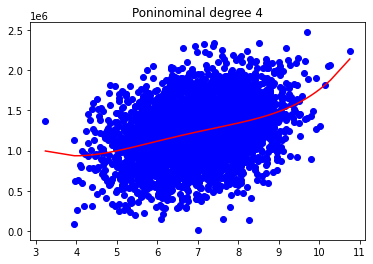

################
[[1.00000000e+00 6.77106398e+00 4.58473075e+01 3.10435052e+02
  2.10197560e+03 1.42326113e+04]
 [1.00000000e+00 5.47525265e+00 2.99783916e+01 1.64139268e+02
  8.98703964e+02 4.92063126e+03]
 [1.00000000e+00 5.45592987e+00 2.97671708e+01 1.62407596e+02
  8.86084455e+02 4.83441464e+03]
 ...
 [1.00000000e+00 5.72736776e+00 3.28027414e+01 1.87873363e+02
  1.07601984e+03 6.16276136e+03]
 [1.00000000e+00 4.70501539e+00 2.21371698e+01 1.04155725e+02
  4.90054287e+02 2.30571296e+03]
 [1.00000000e+00 7.79051750e+00 6.06921630e+01 4.72823358e+02
  3.68353865e+03 2.86966723e+04]]
(4000, 6)
y_pred (4000,)
Score: 0.11495882032926463


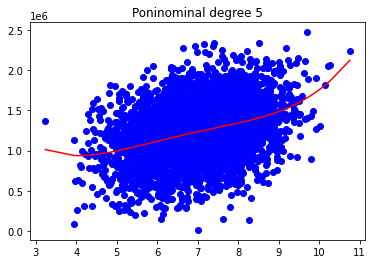

################
[[1.00000000e+00 6.77106398e+00 4.58473075e+01 ... 2.10197560e+03
  1.42326113e+04 9.63699218e+04]
 [1.00000000e+00 5.47525265e+00 2.99783916e+01 ... 8.98703964e+02
  4.92063126e+03 2.69416994e+04]
 [1.00000000e+00 5.45592987e+00 2.97671708e+01 ... 8.86084455e+02
  4.83441464e+03 2.63762273e+04]
 ...
 [1.00000000e+00 5.72736776e+00 3.28027414e+01 ... 1.07601984e+03
  6.16276136e+03 3.52964007e+04]
 [1.00000000e+00 4.70501539e+00 2.21371698e+01 ... 4.90054287e+02
  2.30571296e+03 1.08484150e+04]
 [1.00000000e+00 7.79051750e+00 6.06921630e+01 ... 3.68353865e+03
  2.86966723e+04 2.23561928e+05]]
(4000, 7)
y_pred (4000,)
Score: 0.11499222900750061


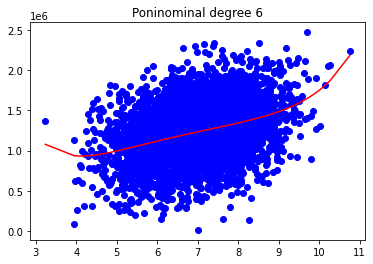

################
[[1.00000000e+00 6.77106398e+00 4.58473075e+01 ... 1.42326113e+04
  9.63699218e+04 6.52526906e+05]
 [1.00000000e+00 5.47525265e+00 2.99783916e+01 ... 4.92063126e+03
  2.69416994e+04 1.47512611e+05]
 [1.00000000e+00 5.45592987e+00 2.97671708e+01 ... 4.83441464e+03
  2.63762273e+04 1.43906846e+05]
 ...
 [1.00000000e+00 5.72736776e+00 3.28027414e+01 ... 6.16276136e+03
  3.52964007e+04 2.02155467e+05]
 [1.00000000e+00 4.70501539e+00 2.21371698e+01 ... 2.30571296e+03
  1.08484150e+04 5.10419593e+04]
 [1.00000000e+00 7.79051750e+00 6.06921630e+01 ... 2.86966723e+04
  2.23561928e+05 1.74166311e+06]]
(4000, 8)
y_pred (4000,)
Score: 0.11499323178502752


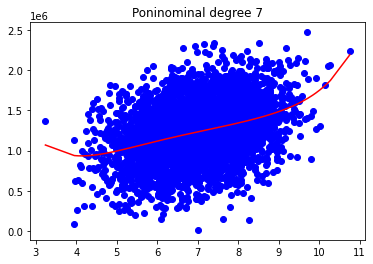

################
[[1.00000000e+00 6.77106398e+00 4.58473075e+01 ... 9.63699218e+04
  6.52526906e+05 4.41830143e+06]
 [1.00000000e+00 5.47525265e+00 2.99783916e+01 ... 2.69416994e+04
  1.47512611e+05 8.07668815e+05]
 [1.00000000e+00 5.45592987e+00 2.97671708e+01 ... 2.63762273e+04
  1.43906846e+05 7.85145661e+05]
 ...
 [1.00000000e+00 5.72736776e+00 3.28027414e+01 ... 3.52964007e+04
  2.02155467e+05 1.15781871e+06]
 [1.00000000e+00 4.70501539e+00 2.21371698e+01 ... 1.08484150e+04
  5.10419593e+04 2.40153204e+05]
 [1.00000000e+00 7.79051750e+00 6.06921630e+01 ... 2.23561928e+05
  1.74166311e+06 1.35684569e+07]]
(4000, 9)
y_pred (4000,)
Score: 0.11593206195853123


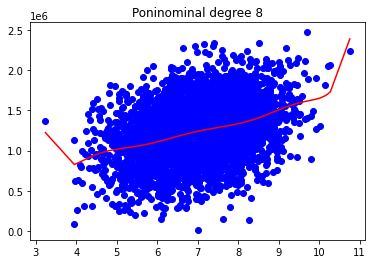

################
[[1.00000000e+00 6.77106398e+00 4.58473075e+01 ... 6.52526906e+05
  4.41830143e+06 2.99166017e+07]
 [1.00000000e+00 5.47525265e+00 2.99783916e+01 ... 1.47512611e+05
  8.07668815e+05 4.42219082e+06]
 [1.00000000e+00 5.45592987e+00 2.97671708e+01 ... 1.43906846e+05
  7.85145661e+05 4.28369966e+06]
 ...
 [1.00000000e+00 5.72736776e+00 3.28027414e+01 ... 2.02155467e+05
  1.15781871e+06 6.63125352e+06]
 [1.00000000e+00 4.70501539e+00 2.21371698e+01 ... 5.10419593e+04
  2.40153204e+05 1.12992452e+06]
 [1.00000000e+00 7.79051750e+00 6.06921630e+01 ... 1.74166311e+06
  1.35684569e+07 1.05705301e+08]]
(4000, 10)
y_pred (4000,)
Score: 0.11714453324314722


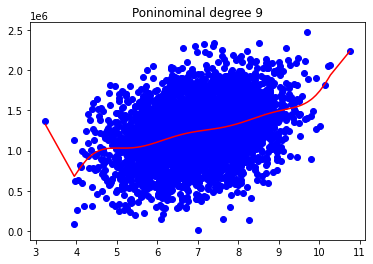

################
[[1.00000000e+00 6.77106398e+00 4.58473075e+01 ... 4.41830143e+06
  2.99166017e+07 2.02567224e+08]
 [1.00000000e+00 5.47525265e+00 2.99783916e+01 ... 8.07668815e+05
  4.42219082e+06 2.42126120e+07]
 [1.00000000e+00 5.45592987e+00 2.97671708e+01 ... 7.85145661e+05
  4.28369966e+06 2.33715649e+07]
 ...
 [1.00000000e+00 5.72736776e+00 3.28027414e+01 ... 1.15781871e+06
  6.63125352e+06 3.79796276e+07]
 [1.00000000e+00 4.70501539e+00 2.21371698e+01 ... 2.40153204e+05
  1.12992452e+06 5.31631225e+06]
 [1.00000000e+00 7.79051750e+00 6.06921630e+01 ... 1.35684569e+07
  1.05705301e+08 8.23499000e+08]]
(4000, 11)
y_pred (4000,)
Score: 0.1173285579629102


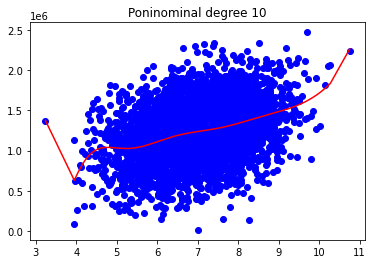

In [20]:
# GRADOS MINIMO Y MAXIMO 
degree_min = 2
degree_max = 10
#ACIERTOS
scores = []
for degree in range(degree_min,degree_max+1):
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    #ENTRENAMOS CON EL CONJUNTO DE ENTRENAMIEMTO
    X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1),y_train)

    #######
    print(X_poly)
    print(X_poly.shape)

    lin_reg_model = LinearRegression() 
    lin_reg_model.fit(X_poly, y_train)#LA REGRESION VA A APRENDER X_POLY PARA ENTRENAR
    y_pred = lin_reg_model.predict(X_poly) #PREDICE LAS Y CON LOS DATOS DE X_POLY

    print("y_pred", y_pred.shape)
    print("Score:", r2_score(y_train, y_pred))

    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
    plt.plot(X_train_to_show, y_pred, color='red')
    plt.title("Poninominal degree " + str(degree))
    plt.show()

In [21]:
X_3=df.iloc[:,3]
X_3

0       4.09
1       3.09
2       5.13
3       3.26
4       4.23
        ... 
4995    3.46
4996    4.02
4997    2.13
4998    5.44
4999    4.07
Name: Avg. Area Number of Bedrooms, Length: 5000, dtype: float64

In [22]:
X_3=np.array(X_3)

In [23]:
X_train, X_test, y_train, y_test = train_test_split(X_3, y,test_size=0.2)

################
[[ 1.      5.34   28.5156]
 [ 1.      3.25   10.5625]
 [ 1.      6.08   36.9664]
 ...
 [ 1.      2.21    4.8841]
 [ 1.      3.3    10.89  ]
 [ 1.      3.37   11.3569]]
(4000, 3)
y_pred (4000,)
Score: 0.03070722908509793


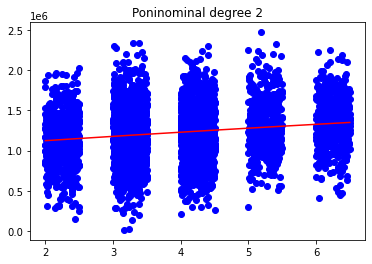

################
[[  1.         5.34      28.5156   152.273304]
 [  1.         3.25      10.5625    34.328125]
 [  1.         6.08      36.9664   224.755712]
 ...
 [  1.         2.21       4.8841    10.793861]
 [  1.         3.3       10.89      35.937   ]
 [  1.         3.37      11.3569    38.272753]]
(4000, 4)
y_pred (4000,)
Score: 0.030931855220862947


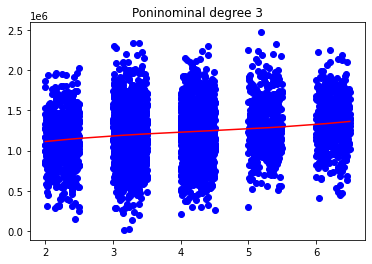

################
[[1.00000000e+00 5.34000000e+00 2.85156000e+01 1.52273304e+02
  8.13139443e+02]
 [1.00000000e+00 3.25000000e+00 1.05625000e+01 3.43281250e+01
  1.11566406e+02]
 [1.00000000e+00 6.08000000e+00 3.69664000e+01 2.24755712e+02
  1.36651473e+03]
 ...
 [1.00000000e+00 2.21000000e+00 4.88410000e+00 1.07938610e+01
  2.38544328e+01]
 [1.00000000e+00 3.30000000e+00 1.08900000e+01 3.59370000e+01
  1.18592100e+02]
 [1.00000000e+00 3.37000000e+00 1.13569000e+01 3.82727530e+01
  1.28979178e+02]]
(4000, 5)
y_pred (4000,)
Score: 0.03424509384902408


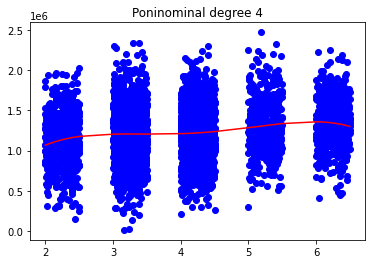

################
[[1.00000000e+00 5.34000000e+00 2.85156000e+01 1.52273304e+02
  8.13139443e+02 4.34216463e+03]
 [1.00000000e+00 3.25000000e+00 1.05625000e+01 3.43281250e+01
  1.11566406e+02 3.62590820e+02]
 [1.00000000e+00 6.08000000e+00 3.69664000e+01 2.24755712e+02
  1.36651473e+03 8.30840955e+03]
 ...
 [1.00000000e+00 2.21000000e+00 4.88410000e+00 1.07938610e+01
  2.38544328e+01 5.27182965e+01]
 [1.00000000e+00 3.30000000e+00 1.08900000e+01 3.59370000e+01
  1.18592100e+02 3.91353930e+02]
 [1.00000000e+00 3.37000000e+00 1.13569000e+01 3.82727530e+01
  1.28979178e+02 4.34659829e+02]]
(4000, 6)
y_pred (4000,)
Score: 0.03456532896884523


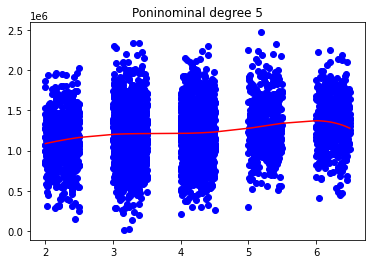

################
[[1.00000000e+00 5.34000000e+00 2.85156000e+01 ... 8.13139443e+02
  4.34216463e+03 2.31871591e+04]
 [1.00000000e+00 3.25000000e+00 1.05625000e+01 ... 1.11566406e+02
  3.62590820e+02 1.17842017e+03]
 [1.00000000e+00 6.08000000e+00 3.69664000e+01 ... 1.36651473e+03
  8.30840955e+03 5.05151301e+04]
 ...
 [1.00000000e+00 2.21000000e+00 4.88410000e+00 ... 2.38544328e+01
  5.27182965e+01 1.16507435e+02]
 [1.00000000e+00 3.30000000e+00 1.08900000e+01 ... 1.18592100e+02
  3.91353930e+02 1.29146797e+03]
 [1.00000000e+00 3.37000000e+00 1.13569000e+01 ... 1.28979178e+02
  4.34659829e+02 1.46480362e+03]]
(4000, 7)
y_pred (4000,)
Score: 0.035517011924414255


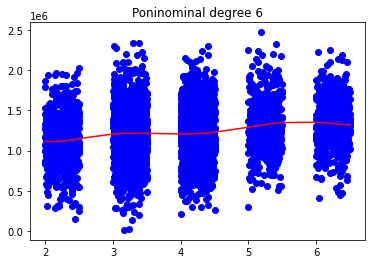

################
[[1.00000000e+00 5.34000000e+00 2.85156000e+01 ... 4.34216463e+03
  2.31871591e+04 1.23819430e+05]
 [1.00000000e+00 3.25000000e+00 1.05625000e+01 ... 3.62590820e+02
  1.17842017e+03 3.82986554e+03]
 [1.00000000e+00 6.08000000e+00 3.69664000e+01 ... 8.30840955e+03
  5.05151301e+04 3.07131991e+05]
 ...
 [1.00000000e+00 2.21000000e+00 4.88410000e+00 ... 5.27182965e+01
  1.16507435e+02 2.57481432e+02]
 [1.00000000e+00 3.30000000e+00 1.08900000e+01 ... 3.91353930e+02
  1.29146797e+03 4.26184430e+03]
 [1.00000000e+00 3.37000000e+00 1.13569000e+01 ... 4.34659829e+02
  1.46480362e+03 4.93638821e+03]]
(4000, 8)
y_pred (4000,)
Score: 0.03551767906246328


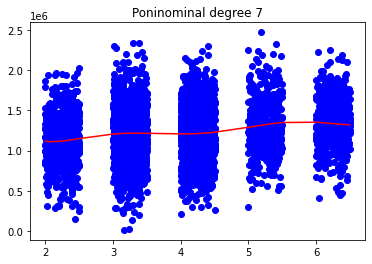

################
[[1.00000000e+00 5.34000000e+00 2.85156000e+01 ... 2.31871591e+04
  1.23819430e+05 6.61195754e+05]
 [1.00000000e+00 3.25000000e+00 1.05625000e+01 ... 1.17842017e+03
  3.82986554e+03 1.24470630e+04]
 [1.00000000e+00 6.08000000e+00 3.69664000e+01 ... 5.05151301e+04
  3.07131991e+05 1.86736250e+06]
 ...
 [1.00000000e+00 2.21000000e+00 4.88410000e+00 ... 1.16507435e+02
  2.57481432e+02 5.69033965e+02]
 [1.00000000e+00 3.30000000e+00 1.08900000e+01 ... 1.29146797e+03
  4.26184430e+03 1.40640862e+04]
 [1.00000000e+00 3.37000000e+00 1.13569000e+01 ... 1.46480362e+03
  4.93638821e+03 1.66356283e+04]]
(4000, 9)
y_pred (4000,)
Score: 0.03554167110838258


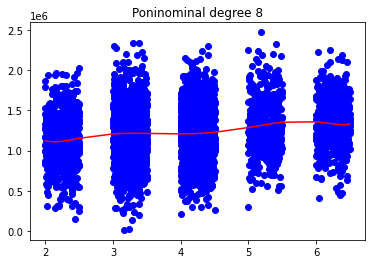

################
[[1.00000000e+00 5.34000000e+00 2.85156000e+01 ... 1.23819430e+05
  6.61195754e+05 3.53078533e+06]
 [1.00000000e+00 3.25000000e+00 1.05625000e+01 ... 3.82986554e+03
  1.24470630e+04 4.04529548e+04]
 [1.00000000e+00 6.08000000e+00 3.69664000e+01 ... 3.07131991e+05
  1.86736250e+06 1.13535640e+07]
 ...
 [1.00000000e+00 2.21000000e+00 4.88410000e+00 ... 2.57481432e+02
  5.69033965e+02 1.25756506e+03]
 [1.00000000e+00 3.30000000e+00 1.08900000e+01 ... 4.26184430e+03
  1.40640862e+04 4.64114844e+04]
 [1.00000000e+00 3.37000000e+00 1.13569000e+01 ... 4.93638821e+03
  1.66356283e+04 5.60620672e+04]]
(4000, 10)
y_pred (4000,)
Score: 0.03573501096200071


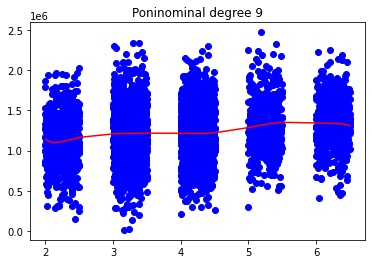

################
[[1.00000000e+00 5.34000000e+00 2.85156000e+01 ... 6.61195754e+05
  3.53078533e+06 1.88543937e+07]
 [1.00000000e+00 3.25000000e+00 1.05625000e+01 ... 1.24470630e+04
  4.04529548e+04 1.31472103e+05]
 [1.00000000e+00 6.08000000e+00 3.69664000e+01 ... 1.86736250e+06
  1.13535640e+07 6.90296693e+07]
 ...
 [1.00000000e+00 2.21000000e+00 4.88410000e+00 ... 5.69033965e+02
  1.25756506e+03 2.77921879e+03]
 [1.00000000e+00 3.30000000e+00 1.08900000e+01 ... 1.40640862e+04
  4.64114844e+04 1.53157899e+05]
 [1.00000000e+00 3.37000000e+00 1.13569000e+01 ... 1.66356283e+04
  5.60620672e+04 1.88929167e+05]]
(4000, 11)
y_pred (4000,)
Score: 0.03575734095524963


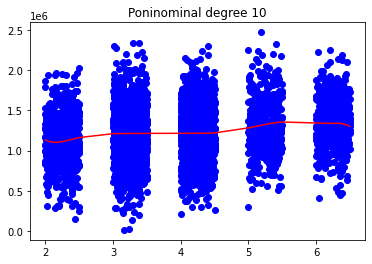

In [24]:
# GRADOS MINIMO Y MAXIMO 
degree_min = 2
degree_max = 10
#ACIERTOS
scores = []
for degree in range(degree_min,degree_max+1):
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    #ENTRENAMOS CON EL CONJUNTO DE ENTRENAMIEMTO
    X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1),y_train)

    #######
    print(X_poly)
    print(X_poly.shape)

    lin_reg_model = LinearRegression() 
    lin_reg_model.fit(X_poly, y_train)#LA REGRESION VA A APRENDER X_POLY PARA ENTRENAR
    y_pred = lin_reg_model.predict(X_poly) #PREDICE LAS Y CON LOS DATOS DE X_POLY

    print("y_pred", y_pred.shape)
    print("Score:", r2_score(y_train, y_pred))

    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
    plt.plot(X_train_to_show, y_pred, color='red')
    plt.title("Poninominal degree " + str(degree))
    plt.show()

In [25]:
X_4=df.iloc[:,4]
X_4

0       23086.800503
1       40173.072174
2       36882.159400
3       34310.242831
4       26354.109472
            ...     
4995    22837.361035
4996    25616.115489
4997    33266.145490
4998    42625.620156
4999    46501.283803
Name: Area Population, Length: 5000, dtype: float64

In [26]:
X_4=np.array(X_4)

In [27]:
X_train, X_test, y_train, y_test = train_test_split(X_4, y,test_size=0.2)

################
[[1.00000000e+00 3.80392530e+04 1.44698477e+09]
 [1.00000000e+00 2.91142881e+04 8.47641774e+08]
 [1.00000000e+00 6.03091222e+04 3.63719023e+09]
 ...
 [1.00000000e+00 5.31523495e+04 2.82517225e+09]
 [1.00000000e+00 2.47482683e+04 6.12476782e+08]
 [1.00000000e+00 5.15095993e+04 2.65323882e+09]]
(4000, 3)
y_pred (4000,)
Score: 0.17166556343818717


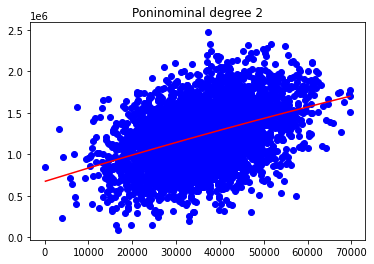

################
[[1.00000000e+00 3.80392530e+04 1.44698477e+09 5.50422197e+13]
 [1.00000000e+00 2.91142881e+04 8.47641774e+08 2.46784869e+13]
 [1.00000000e+00 6.03091222e+04 3.63719023e+09 2.19355750e+14]
 ...
 [1.00000000e+00 5.31523495e+04 2.82517225e+09 1.50164543e+14]
 [1.00000000e+00 2.47482683e+04 6.12476782e+08 1.51577397e+13]
 [1.00000000e+00 5.15095993e+04 2.65323882e+09 1.36667268e+14]]
(4000, 4)
y_pred (4000,)
Score: 0.17179386299144683


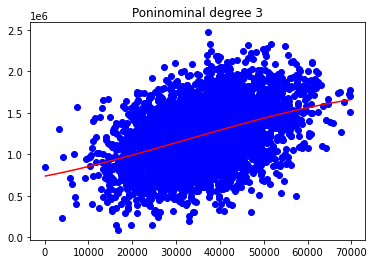

################
[[1.00000000e+00 3.80392530e+04 1.44698477e+09 5.50422197e+13
  2.09376492e+18]
 [1.00000000e+00 2.91142881e+04 8.47641774e+08 2.46784869e+13
  7.18496577e+17]
 [1.00000000e+00 6.03091222e+04 3.63719023e+09 2.19355750e+14
  1.32291527e+19]
 ...
 [1.00000000e+00 5.31523495e+04 2.82517225e+09 1.50164543e+14
  7.98159827e+18]
 [1.00000000e+00 2.47482683e+04 6.12476782e+08 1.51577397e+13
  3.75127809e+17]
 [1.00000000e+00 5.15095993e+04 2.65323882e+09 1.36667268e+14
  7.03967623e+18]]
(4000, 5)
y_pred (4000,)
Score: 0.17184535548315527


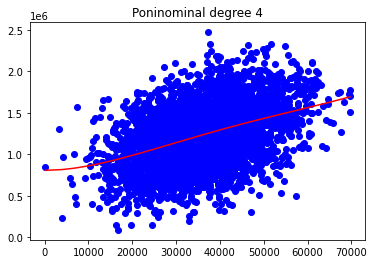

################
[[1.00000000e+00 3.80392530e+04 1.44698477e+09 5.50422197e+13
  2.09376492e+18 7.96452535e+22]
 [1.00000000e+00 2.91142881e+04 8.47641774e+08 2.46784869e+13
  7.18496577e+17 2.09185164e+22]
 [1.00000000e+00 6.03091222e+04 3.63719023e+09 2.19355750e+14
  1.32291527e+19 7.97838590e+23]
 ...
 [1.00000000e+00 5.31523495e+04 2.82517225e+09 1.50164543e+14
  7.98159827e+18 4.24240700e+23]
 [1.00000000e+00 2.47482683e+04 6.12476782e+08 1.51577397e+13
  3.75127809e+17 9.28376365e+21]
 [1.00000000e+00 5.15095993e+04 2.65323882e+09 1.36667268e+14
  7.03967623e+18 3.62610902e+23]]
(4000, 6)
y_pred (4000,)
Score: 0.17124840958268117


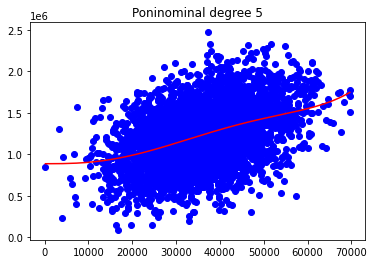

################
[[1.00000000e+00 3.80392530e+04 1.44698477e+09 ... 2.09376492e+18
  7.96452535e+22 3.02964595e+27]
 [1.00000000e+00 2.91142881e+04 8.47641774e+08 ... 7.18496577e+17
  2.09185164e+22 6.09027713e+26]
 [1.00000000e+00 6.03091222e+04 3.63719023e+09 ... 1.32291527e+19
  7.97838590e+23 4.81169451e+28]
 ...
 [1.00000000e+00 5.31523495e+04 2.82517225e+09 ... 7.98159827e+18
  4.24240700e+23 2.25493900e+28]
 [1.00000000e+00 2.47482683e+04 6.12476782e+08 ... 3.75127809e+17
  9.28376365e+21 2.29757073e+26]
 [1.00000000e+00 5.15095993e+04 2.65323882e+09 ... 7.03967623e+18
  3.62610902e+23 1.86779423e+28]]
(4000, 7)
y_pred (4000,)
Score: 0.16928935810737655


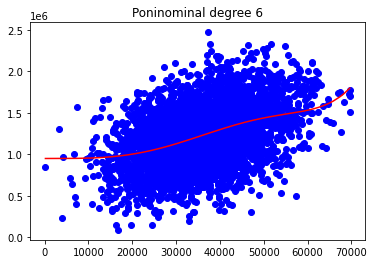

################
[[1.00000000e+00 3.80392530e+04 1.44698477e+09 ... 7.96452535e+22
  3.02964595e+27 1.15245469e+32]
 [1.00000000e+00 2.91142881e+04 8.47641774e+08 ... 2.09185164e+22
  6.09027713e+26 1.77314083e+31]
 [1.00000000e+00 6.03091222e+04 3.63719023e+09 ... 7.97838590e+23
  4.81169451e+28 2.90189072e+33]
 ...
 [1.00000000e+00 5.31523495e+04 2.82517225e+09 ... 4.24240700e+23
  2.25493900e+28 1.19855306e+33]
 [1.00000000e+00 2.47482683e+04 6.12476782e+08 ... 9.28376365e+21
  2.29757073e+26 5.68608969e+30]
 [1.00000000e+00 5.15095993e+04 2.65323882e+09 ... 3.62610902e+23
  1.86779423e+28 9.62093321e+32]]
(4000, 8)
y_pred (4000,)
Score: 0.16568595737224234


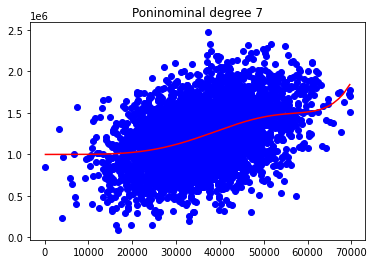

################
[[1.00000000e+00 3.80392530e+04 1.44698477e+09 ... 3.02964595e+27
  1.15245469e+32 4.38385154e+36]
 [1.00000000e+00 2.91142881e+04 8.47641774e+08 ... 6.09027713e+26
  1.77314083e+31 5.16237331e+35]
 [1.00000000e+00 6.03091222e+04 3.63719023e+09 ... 4.81169451e+28
  2.90189072e+33 1.75010482e+38]
 ...
 [1.00000000e+00 5.31523495e+04 2.82517225e+09 ... 2.25493900e+28
  1.19855306e+33 6.37059109e+37]
 [1.00000000e+00 2.47482683e+04 6.12476782e+08 ... 2.29757073e+26
  5.68608969e+30 1.40720873e+35]
 [1.00000000e+00 5.15095993e+04 2.65323882e+09 ... 1.86779423e+28
  9.62093321e+32 4.95570414e+37]]
(4000, 9)
y_pred (4000,)
Score: 0.1604861343458358


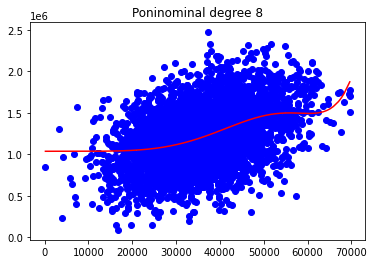

################
[[1.00000000e+00 3.80392530e+04 1.44698477e+09 ... 1.15245469e+32
  4.38385154e+36 1.66758438e+41]
 [1.00000000e+00 2.91142881e+04 8.47641774e+08 ... 1.77314083e+31
  5.16237331e+35 1.50298824e+40]
 [1.00000000e+00 6.03091222e+04 3.63719023e+09 ... 2.90189072e+33
  1.75010482e+38 1.05547286e+43]
 ...
 [1.00000000e+00 5.31523495e+04 2.82517225e+09 ... 1.19855306e+33
  6.37059109e+37 3.38611884e+42]
 [1.00000000e+00 2.47482683e+04 6.12476782e+08 ... 5.68608969e+30
  1.40720873e+35 3.48259792e+39]
 [1.00000000e+00 5.15095993e+04 2.65323882e+09 ... 9.62093321e+32
  4.95570414e+37 2.55266335e+42]]
(4000, 10)
y_pred (4000,)
Score: 0.15390952044446993


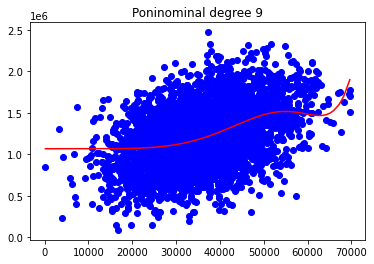

################
[[1.00000000e+00 3.80392530e+04 1.44698477e+09 ... 4.38385154e+36
  1.66758438e+41 6.34336640e+45]
 [1.00000000e+00 2.91142881e+04 8.47641774e+08 ... 5.16237331e+35
  1.50298824e+40 4.37584327e+44]
 [1.00000000e+00 6.03091222e+04 3.63719023e+09 ... 1.75010482e+38
  1.05547286e+43 6.36546416e+47]
 ...
 [1.00000000e+00 5.31523495e+04 2.82517225e+09 ... 6.37059109e+37
  3.38611884e+42 1.79980172e+47]
 [1.00000000e+00 2.47482683e+04 6.12476782e+08 ... 1.40720873e+35
  3.48259792e+39 8.61882676e+43]
 [1.00000000e+00 5.15095993e+04 2.65323882e+09 ... 4.95570414e+37
  2.55266335e+42 1.31486666e+47]]
(4000, 11)
y_pred (4000,)
Score: 0.14624400544335048


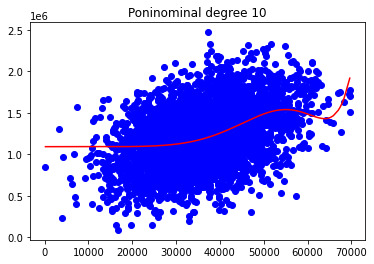

In [28]:
# GRADOS MINIMO Y MAXIMO 
degree_min = 2
degree_max = 10
#ACIERTOS
scores = []
for degree in range(degree_min,degree_max+1):
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    #ENTRENAMOS CON EL CONJUNTO DE ENTRENAMIEMTO
    X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1),y_train)

    #######
    print(X_poly)
    print(X_poly.shape)

    lin_reg_model = LinearRegression() 
    lin_reg_model.fit(X_poly, y_train)#LA REGRESION VA A APRENDER X_POLY PARA ENTRENAR
    y_pred = lin_reg_model.predict(X_poly) #PREDICE LAS Y CON LOS DATOS DE X_POLY

    print("y_pred", y_pred.shape)
    print("Score:", r2_score(y_train, y_pred))

    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
    plt.plot(X_train_to_show, y_pred, color='red')
    plt.title("Poninominal degree " + str(degree))
    plt.show()